# ANAELE EXPLORATION

In [1]:
# Import required libraries to run the naive baseline
import pandas as pd
import numpy as np
from PIL import Image
import cv2
from tqdm import tqdm
from collections import OrderedDict
import matplotlib.pyplot as plt
import pickle

import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
from torchvision.models import mobilenet_v3_small

In [2]:
#############################################
# FUNCTIONS
#############################################

# PREPROCESSING
# --------------------------------------------

# function to check if image is black and white


def is_color(img):
    # check if image has 3 channels
    dim = len(np.array(img).shape)
    
    if dim == 2: # with 1 channel dimension = (224,224) => greyscale image
        return 0
    # if image has 3 channels and all channels are equal
    elif dim == 3: # for example (224, 224, 3)
        if ((np.array(img)[:,:,2] == np.array(img)[:,:,1]).all() == True &
            (np.array(img)[:,:,0] == np.array(img)[:,:,1]).all() == True &
            (np.array(img)[:,:,0] == np.array(img)[:,:,2]).all() == True ):
            return 0
        else:
            return 1
    else:
        return 0

def preprocess_df(df, image_dir, process_mediapipe=False):
    # add gender and FaceOcclusion columns with -1 values (for test)
    if 'gender' not in df.columns:
        df['gender'] = - np.ones(len(df)).astype(float)
    if 'FaceOcclusion' not in df.columns:
        df['FaceOcclusion'] = -np.ones(len(df)).astype(float)
        
    # preprocess the dataframe
    df['initial_index'] = df.index
    df = df.dropna(subset=['FaceOcclusion'])
    df['gender_id'] = np.round(df['gender'] ).astype(int)
    df['db_number'] = df['filename'].apply(lambda x: (x.split('/')[0])[-1])
    df['db_number'] = df['db_number'].astype(int)
    df['count']=1

    # add columns for the image properties
    df['color']= 0 # 1 = color 0 = black & white (grayscale)
    df['image_width'] = np.zeros(len(df)).astype(int)
    df['image_height'] = np.zeros(len(df)).astype(int)
    df['channels'] = np.zeros(len(df)).astype(int)
    df['pixels'] = np.zeros(len(df)).astype(int)

    if process_mediapipe == True:
        df['face'] = np.ones(len(df)).astype(int)   # 1 = 1 face detected, 0 = no face detected
        df['face_pixels'] = np.zeros(len(df)).astype(int)
        df['mask_pixels'] = np.zeros(len(df)).astype(int)
        print('use preprocessing _mediapipe file to get mediapipe mask, mesh and contours')

    # loop through the images to extract properties
    for i in df.index:

        if i % 5000 == 0: print(i)

        try:
            filename = df.loc[i, 'filename']
    
            # load image; convert and save information
            image = cv2.imread(f"{image_dir}/{filename}")
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            
            df.loc[i, 'image_width'] = image.shape[0]
            df.loc[i, 'image_height'] = image.shape[1]
            df.loc[i, 'pixels'] = image.shape[0] * image.shape[1]
            df.loc[i, 'channels'] = image.shape[2]

            if is_color(image)==1:
                df.loc[i, 'color'] = 1

            if process_mediapipe == True:
                # to be added
                print('use preprocessing _mediapipe file to get mediapipe mask, mesh and contours')

        except ValueError as e:
            print(f'could not open {filename} (index {i}): {e}')

    df['no_color']= 1 - df['color']

    return df

def process_mediapipe(df, image_dir, save_to_file=False):
    '''function to apply mediapipe face mesh model to images, get masked images, 
    contours and mesh, and return 468 landmarks (3D keypoints)
    Input :
        df : panda dataframe with image filenames
        image_dir : directory where images are stored
    Output :
        df : panda dataframe with additional columns for number of faces detected, face pixels, mask pixels,
        masked_image: image with skin area, ans black mask overlay (ovale) elsewhere 
        contours : image with face ovale contours, brows and lips in green
        mesh : image with face mesh keypoints
        landmarks : 468 landmarks (3D keypoints) in mediapipe format (madiapipe array of (x, y, z) coordinates in dictionary format)
    '''
#---------------------------------------
# SHOW IMAGES
#---------------------------------------

def show_images(df, image_dir, n_images=5, title='None'):
    N = len(df)
    plt.figure(figsize=(15, (N//5 + 1)*3))
    for i in range(N):
        plt.subplot(N//5 + 1, n_images, i + 1)
        img = Image.open(f"{image_dir}/{df.iloc[i]['filename']}")
        plt.imshow(img)
        plt.axis('off')
    plt.suptitle(title)
    plt.show()

#---------------------------------------
# DEFINE DEVICE
#---------------------------------------
def get_device():
    if torch.cuda.is_available():
        device = "cuda"
    elif torch.backends.mps.is_available():
        device = "mps"
    else:
        device = "cpu"
    return device

#---------------------------------------
# DEFINE DATASET CLASS
#---------------------------------------

#class Dataset(torch.utils.data.Dataset): # in "starter notebook code" dataset is imported from torch.utils.data
class Dataset(torch.utils.data.Dataset):
    'Characterizes a dataset for PyTorch'
    def __init__(self, df, image_dir):
         'Initialization'
         self.image_dir = image_dir
         self.df = df
         self.transform = transforms.ToTensor()
         
    def __len__(self):
        'Denotes the total number of samples'
        return len(self.df)

    def __getitem__(self, index):
        'Generates one sample of data'
        # Select sample
        row = self.df.loc[index]
        filename = row['filename']

        # Load data and get label
        img = Image.open(f"{self.image_dir}/{filename}")  
        X = self.transform(img)

        y = row['FaceOcclusion']     
        y = np.float32(y)

        gender = row['gender_id'] # changed to have round values 0 or 1

        return X, y, gender, filename

#--------------------------------------------------
# Compute mean and standard deviation on the pixels
#--------------------------------------------------

def calculate_mean_std(loader, num_channels=3):
    '''Calculate mean and standard deviation of the dataset.
    Args:
        loader: DataLoader object
        num_channels: number of channels
    Returns:
        mean: mean of the dataset (tensor)
        std: standard deviation of the dataset (tensor)
    '''
    device = get_device()
    channel_sum = torch.zeros(num_channels).to(device)
    channel_squared_sum = torch.zeros(num_channels).to(device)
    num_elements = 0

    for data, _, _, _ in loader:
        data = data.to(device)
        channel_sum += data.sum(dim=[0, 2, 3])
        channel_squared_sum += (data ** 2).sum(dim=[0, 2, 3])
        num_elements += data.size(0) * data.size(2) * data.size(3)

    mean = channel_sum / num_elements
    std = (channel_squared_sum / num_elements - mean ** 2) ** 0.5
    return mean, std

In [3]:
df_train = pd.read_csv("Data/listes_training/data_100K/train_100K.csv", delimiter=' ')
df_test = pd.read_csv("Data/listes_training/data_100K/test_students.csv", delimiter=' ')

image_dir = "Data/crops_100K"
device = get_device()
print('device:', device)

df_train.head(-10)

device: cuda


,filename,FaceOcclusion,gender
0,database1/img00011271.jpg,0.019,0.999
1,database1/img00012471.jpg,0.035,1.000
2,database1/img00008127.jpg,0.127,0.001
3,database1/img00008972.jpg,0.014,0.999
4,database1/img00028187.jpg,0.346,0.982
...,...,...,...
101330,database3/database3/m.01drbr/59-FaceId-0_align...,0.000,1.000
101331,database3/database3/m.01drbr/69-FaceId-0_align...,0.021,0.998
101332,database3/database3/m.01drbr/7-FaceId-0_align.jpg,0.008,1.000
101333,database3/database3/m.01drbr/71-FaceId-0_align...,0.005,1.000


In [4]:
df_test.head(-10)

,filename
0,database2/database2/test/0.jpg
1,database2/database2/test/1.jpg
2,database2/database2/test/2.jpg
3,database2/database2/test/3.jpg
4,database2/database2/test/4.jpg
...,...
30492,database3/database3/m.01507p/75-FaceId-0_align...
30493,database3/database3/m.01507p/76-FaceId-0_align...
30494,database3/database3/m.01507p/77-FaceId-0_align...
30495,database3/database3/m.01507p/78-FaceId-0_align...


# 1 Data exploration

In [5]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 101345 entries, 0 to 101344
Data columns (total 3 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   filename       101345 non-null  object 
 1   FaceOcclusion  101341 non-null  float64
 2   gender         101345 non-null  float64
dtypes: float64(2), object(1)
memory usage: 2.3+ MB


In [6]:
# Preprocessing
preprocess = False

if preprocess== True:
    print('Preprocessing train dataset')
    df_train = preprocess_df(df_train, image_dir, process_mediapipe=False)
    print('\nPreprocessing test dataset')
    df_test = preprocess_df(df_test, image_dir, process_mediapipe=False)
    with open('df_train.pkl', 'wb') as file: pickle.dump(df_train, file)
    with open('df_test.pkl', 'wb') as file:  pickle.dump(df_test, file)
else:
    with open('df_train.pkl', 'rb') as file:
        df_train = pickle.load(file)
    with open('df_test.pkl', 'rb') as file:
        df_test = pickle.load(file)

# print('Preprocessing train dataset')
# df_train_pp = preprocess_df(df_train, image_dir, process_mediapipe=False)
# print('\nPreprocessing test dataset')
# df_test_pp = preprocess_df(df_test, image_dir, process_mediapipe=False)

Preprocessing train dataset
0


/tmp/ipykernel_64034/1591410725.py:38: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['gender_id'] = np.round(df_train['gender'] ).astype(int)
/tmp/ipykernel_64034/1591410725.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['db_number'] = df['filename'].apply(lambda x: (x.split('/')[0])[-1])
/tmp/ipykernel_64034/1591410725.py:40: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the

5000
10000
15000
20000
25000
30000
35000
40000
45000
50000
55000
60000
65000
70000
75000
80000
85000
90000
95000
100000


/tmp/ipykernel_64034/1591410725.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['no_color']= 1 - df['color']



Preprocessing test dataset
0
5000
10000
15000
20000
25000
30000


In [7]:
# # drop the rows where FaceOcclusion is empty & add binary gender column

# df_train = df_train.dropna(subset=['FaceOcclusion'])
# df_train['gender_id'] = np.round(df_train['gender'] ).astype(int)
# df_train['db_number'] = df_train['filename'].apply(lambda x: (x.split('/')[0])[-1])
# df_train['db_number'] = df_train['db_number'].astype(int)
# df_train['count']=1
# df_train.info()

In [13]:
df_train.describe()

,FaceOcclusion,gender,initial_index,gender_id,db_number,count,color,image_width,image_height,channels,pixels,no_color
count,101341.000000,101341.000000,101341.000000,101341.000000,101341.000000,101341.0,101341.000000,101341.0,101341.0,101341.0,101341.0,101341.000000
mean,0.087769,0.599738,50671.339093,0.601080,2.394668,1.0,0.861112,224.0,224.0,3.0,50176.0,0.138888
std,0.090530,0.486110,29256.219556,0.489679,0.911578,0.0,0.345831,0.0,0.0,0.0,0.0,0.345831
min,0.000000,0.000000,0.000000,0.000000,1.000000,1.0,0.000000,224.0,224.0,3.0,50176.0,0.000000
25%,0.019000,0.001000,25335.000000,0.000000,1.000000,1.0,1.000000,224.0,224.0,3.0,50176.0,0.000000
50%,0.054000,0.996000,50670.000000,1.000000,3.000000,1.0,1.000000,224.0,224.0,3.0,50176.0,0.000000
75%,0.131000,0.999000,76008.000000,1.000000,3.000000,1.0,1.000000,224.0,224.0,3.0,50176.0,0.000000
max,1.000000,1.000000,101344.000000,1.000000,3.000000,1.0,1.000000,224.0,224.0,3.0,50176.0,1.000000


In [14]:
df_test.describe()

,gender,FaceOcclusion,initial_index,gender_id,db_number,count,color,image_width,image_height,channels,pixels,no_color
count,30507.0,30507.0,30507.000000,30507.000000,30507.000000,30507.0,30507.000000,30507.0,30507.0,30507.0,30507.0,30507.000000
mean,-1.0,-1.0,15253.000000,0.365654,2.983381,1.0,0.807225,224.0,224.0,3.0,50176.0,0.192775
std,0.0,0.0,8806.756667,0.481621,0.127842,0.0,0.394485,0.0,0.0,0.0,0.0,0.394485
min,-1.0,-1.0,0.000000,0.000000,2.000000,1.0,0.000000,224.0,224.0,3.0,50176.0,0.000000
25%,-1.0,-1.0,7626.500000,0.000000,3.000000,1.0,1.000000,224.0,224.0,3.0,50176.0,0.000000
50%,-1.0,-1.0,15253.000000,0.000000,3.000000,1.0,1.000000,224.0,224.0,3.0,50176.0,0.000000
75%,-1.0,-1.0,22879.500000,1.000000,3.000000,1.0,1.000000,224.0,224.0,3.0,50176.0,0.000000
max,-1.0,-1.0,30506.000000,1.000000,3.000000,1.0,1.000000,224.0,224.0,3.0,50176.0,1.000000


In [49]:
# CONCLUSION DU PREPROCESSING :
# -----------------------------
# Average face occlusion is 8.8% (median 5.4%) with a standard deviation of 9.1% => really not a gausian distribution !
# 60.1% of images are men (gender_id=1) and 39.9% are women. Information not available in test dataset
# All images can be read, but some are black and white
# All images havethe same format (224x224) and 3 channels
# 86.1% of images are in color and 13.9% in black and white (80.7% and 19.3% in test)

# 1. Image - source, color ratio and gender

## 1.1 Image source, color ratio and gender

In [ ]:
df_train['women'] = 1 - df_train['gender_id']
df_train['women_occ'] = df_train['FaceOcclusion'] * df_train['women']
df_train['men_occ'] = df_train['FaceOcclusion'] * df_train['gender_id']

stats_db = df_train.groupby('db_number')[['FaceOcclusion','count', 'color', 'no_color','gender_id','men_occ','women','women_occ']].sum()
# add total row
stats_db.loc['total'] = stats_db.sum()
# get mean Face occlusion
stats_db['FaceOcclusion'] = stats_db['FaceOcclusion'] / stats_db['count']
stats_db['men_occ']   = stats_db['men_occ'] / stats_db['gender_id']
stats_db['women_occ'] = stats_db['women_occ'] / stats_db['women']
# format to get ratios in %                  
stats_db['db_ratio'] = (stats_db['count'] / len(df_train)) .map('{:.2%}'.format)
stats_db['color_ratio'] = (stats_db['color'] / stats_db['count']) .map('{:.2%}'.format)
stats_db['no_color_ratio'] = (stats_db['no_color'] / stats_db['count']) .map('{:.2%}'.format)
stats_db['men_ratio'] = ( stats_db['gender_id'] / stats_db['count']) .map('{:.2%}'.format)
stats_db['women_ratio'] = ( stats_db['women'] / stats_db['count']) .map('{:.2%}'.format)
stats_db['Occlusion_ratio'] = stats_db['FaceOcclusion'].map('{:.2%}'.format)
stats_db['men_occ_ratio'] = stats_db['men_occ'].map('{:.2%}'.format)
stats_db['women_occ_ratio'] = stats_db['women_occ'].map('{:.2%}'.format)
stats_db['|'] = '|'
stats_db = stats_db[['Occlusion_ratio','|','count', 'db_ratio','|', 'color', 'color_ratio', 'no_color', 'no_color_ratio','|','gender_id','men_ratio','men_occ_ratio','|','women','women_ratio','women_occ_ratio']]

#show stats on train dataset
stats_db


,Occlusion_ratio,count,db_ratio,color,color_ratio,no_color,no_color_ratio,gender_id,men_ratio,men_occ_ratio,women,women_ratio,women_occ_ratio
db_number,,,,,,,,,,,,,
1,11.42%,30000.0,29.60%,30000.0,100.00%,0.0,0.00%,10845.0,36.15%,7.49%,19155.0,63.85%,13.65%
2,12.99%,1345.0,1.33%,1234.0,91.75%,111.0,8.25%,717.0,53.31%,8.93%,628.0,46.69%,17.62%
3,7.56%,69996.0,69.07%,56032.0,80.05%,13964.0,19.95%,49352.0,70.51%,5.59%,20644.0,29.49%,12.28%
total,8.78%,101341.0,100.00%,87266.0,86.11%,14075.0,13.89%,60914.0,60.11%,5.97%,40427.0,39.89%,13.01%


In [51]:
# CONCLUSION OF ANALYSIS OF FACE OCCLUSION, COLOR AND GENDER
# ----------------------------------------------------------
# The 3 data sources do not share the same distribution in many regards :
#   - face occlusion is 8.78% overall, higher in db1 and db2 (11.4% and 13.0%), and lower in db3 (7.6%), partly due to gender distribution
#   - face occlusion is and lower for men (6.0%) and than for womne (13%), and particularly high in db2 (13.0% overall and 17.6% for women)
#   - gender is imbalanced with 60% of men and 40% of women, with strong disparities between databases (db1 has 36%-64% distribution, db2 has 53%-47% and db3 has 70%-30%)
#   - color images account for 86.1% of images: db1 has only color images, whereas db2 and db3 contain 8.2% and 20% respectively of black and white images (with all 3 channels identical)

# In summary for each database in the train dataset :
#   - db1 : high face occlusion (11.42% overall and 13.7.% for women), mainly women (34%-64%), only color images
#   - db2 : very high face occlusion (13.0% overall and 17.6% for women), almost balanced gender (53%-47%), 8.2% black and white images
#   - db3 : low face occlusion (7.6% overall and 12.3% for women), mainly men (71%-29%), 20% black and white images

In [ ]:
# analysis of gender within color images and black and white images



In [ ]:
stats_test_db = df_test.groupby('db_number')[['count', 'color', 'no_color']].sum()
stats_test_db.loc['total'] = stats_test_db.sum()
stats_test_db['db_ratio'] = (stats_test_db['count'] / len(df_test)) .map('{:.2%}'.format)
stats_test_db['color_ratio'] = (stats_test_db['color'] / stats_test_db['count']) .map('{:.2%}'.format)
stats_test_db['no_color_ratio'] = (stats_test_db['no_color'] / stats_test_db['count']) .map('{:.2%}'.format)
stats_test_db['|'] = '|'
stats_test_db = stats_test_db[['count', 'db_ratio','|', 'color', 'color_ratio', 'no_color', 'no_color_ratio','|']]
stats_test_db

,count,db_ratio,color,color_ratio,no_color,no_color_ratio
db_number,,,,,,
2,507,1.66%,475,93.69%,32,6.31%
3,30000,98.34%,24151,80.50%,5849,19.50%
total,30507,100.00%,24626,80.72%,5881,19.28%


In [53]:
# CONCLUSION OF ANALYSIS OF TEST DATASET
# --------------------------------------

# db 3 composed almost all of the test dataset (98.3%), db2 only 1.7% and db1 is absent
# slighlty lower proportion of color images (81%) in test dataset versus train dataset (86%)

# gender is unknown in the test dataset, but could be estimated by training a model from the train dataset and applying it to the test dataset

# Need to take into account the differences in distribution between train and test datasets when training the model
# => need to balance datasets (data augmentation, oversampling, undersampling, etc.) or apply wieghts in the training process
# => it will be interesting to train a black and white model and a color model and combine the predictions, as pixel distribution will be very different
# it could be interesting to train men and women models separately, as face occlusion levels are very different between them
#  
# => 4 models all together to train if crossing gender with color and black and white images)


In [65]:

# # detail of black and white photos by gender
# stats_bw_gender = df_train.groupby(['db_number','gender_'])['black_and_white','count','gender_'].sum()

# # add a total row, total men and total women
# stats_bw_gender.loc['total'] = stats_bw_gender.sum()
# stats_bw_gender.loc['total women'] = stats_bw_gender[stats_bw_gender['gender_'] == 0].sum()
# stats_bw_gender.loc['total men'] = stats_bw_gender.loc['total'] - stats_bw_gender.loc['total women']

# # add a column with % 
# stats_bw_gender['bw_pc'] = stats_bw_gender['black_and_white'] / stats_bw_gender['count']

# stats_bw_gender

## 1.2 Pixel distribution

In [68]:
# EXPLORE PIXEL DISTRIBUTION BY COLOR AND GENDER
# ----------------------------------------------
# Train dataset
df = df_train.reset_index(drop=True)
df_color = df_train[df_train['color']==1].reset_index(drop=True)
df_color_w = df_color[df_color['gender_id']==0].reset_index(drop=True)
df_color_m = df_color[df_color['gender_id']==1].reset_index(drop=True)
df_gray = df_train[df_train['color']==0].reset_index(drop=True)
df_gray_w = df_gray[df_gray['gender_id']==0].reset_index(drop=True)
df_gray_m = df_gray[df_gray['gender_id']==1].reset_index(drop=True)
# Test dataset
df_test = df_test.reset_index(drop=True)
df_test_color = df_test[df_test['color']==1].reset_index(drop=True)
df_test_gray = df_test[df_test['color']==0].reset_index(drop=True)


# generate datasets for database 1 and 3
image_dir = 'Data/crops_100K'
set = Dataset(df, image_dir)
set_color = Dataset(df_color, image_dir)
set_color_w = Dataset(df_color_w, image_dir)
set_color_m = Dataset(df_color_m, image_dir)
set_gray = Dataset(df_gray, image_dir)
set_gray_w = Dataset(df_gray_w, image_dir)
set_gray_m = Dataset(df_gray_m, image_dir)

set_test = Dataset(df_test, image_dir)
set_test_color = Dataset(df_test_color, image_dir)
set_test_gray = Dataset(df_test_gray, image_dir)

# Create DataLoaders
params = {'batch_size': 1024,
          'shuffle': False,
          'num_workers': 0}

loader = torch.utils.data.DataLoader(set, **params)
loader_color = torch.utils.data.DataLoader(set_color, **params)
loader_color_w = torch.utils.data.DataLoader(set_color_w, **params)
loader_color_m = torch.utils.data.DataLoader(set_color_m, **params)
loader_gray = torch.utils.data.DataLoader(set_gray, **params)
loader_gray_w = torch.utils.data.DataLoader(set_gray_w, **params)
loader_gray_m = torch.utils.data.DataLoader(set_gray_m, **params)

loader_test = torch.utils.data.DataLoader(set_test, **params)
loader_test_color = torch.utils.data.DataLoader(set_test_color, **params)
loader_test_gray = torch.utils.data.DataLoader(set_test_gray, **params)

# Pixel mean by gender and channel
print('PIXEL MEAN BY IMAGE COLOR & GENDER ')
print('--------------------------------')
print('\nTRAIN DATASET')
mean, std = calculate_mean_std(loader, num_channels=3)
print('train all:        ', mean.cpu().numpy(), 'std', std.cpu().numpy())
mean_color, std_color = calculate_mean_std(loader_color, num_channels=3)
print('train color:      ', mean_color.cpu().numpy(), 'std', std_color.cpu().numpy())
mean_color_w, std_color_w = calculate_mean_std(loader_color_w, num_channels=3)
print('train color women:', mean_color_w.cpu().numpy(), 'std', std_color_w.cpu().numpy())
mean_color_m, std_color_m = calculate_mean_std(loader_color_m, num_channels=3)
print('train color men:  ', mean_color_m.cpu().numpy(), 'std', std_color_m.cpu().numpy())
mean_gray, std_gray = calculate_mean_std(loader_gray, num_channels=3)
print('train gray:       ', mean_gray.cpu().numpy(), 'std', std_gray.cpu().numpy())
mean_gray_w, std_gray_w = calculate_mean_std(loader_gray_w, num_channels=3)
print('train gray women: ', mean_gray_w.cpu().numpy(), 'std', std_gray_w.cpu().numpy())
mean_gray_m, std_gray_m = calculate_mean_std(loader_gray_m, num_channels=3)
print('train gray men:   ', mean_gray_m.cpu().numpy(), 'std', std_gray_m.cpu().numpy())

print('TEST DATASET')
mean_test, std_test = calculate_mean_std(loader_test, num_channels=3)
print('test all:         ', mean_test.cpu().numpy(), 'std', std_test.cpu().numpy())
mean_test_color, std_test_color = calculate_mean_std(loader_test_color, num_channels=3)
print('test color:       ', mean_test_color.cpu().numpy(), 'std', std_test_color.cpu().numpy())
mean_test_gray, std_test_gray = calculate_mean_std(loader_test_gray, num_channels=3)
print('test gray:        ', mean_test_gray.cpu().numpy(), 'std', std_test_gray.cpu().numpy())


PIXEL MEAN BY IMAGE COLOR & GENDER 
--------------------------------

TRAIN DATASET


KeyboardInterrupt: 

In [ ]:
# EXPLORE PIXEL DISTRIBUTION BY DATABASE SOURCE BY GENDER AND BY COLOR
# ---------------------------------------------------------------------

# split dataframes by database source and take only color images
df_color_1 = df_train[(df_train['db_number'] == 1) & (df_train['color'] == 1)].reset_index(drop=True)
df_color_2 = df_train[(df_train['db_number'] == 2) & (df_train['color'] == 1)].reset_index(drop=True)
df_color_3 = df_train[(df_train['db_number'] == 3) & (df_train['color'] == 1)].reset_index(drop=True)
df_color_3_m = df_color_3[df_color_3['gender_id']==1].reset_index(drop=True)
df_color_3_w = df_color_3[df_color_3['gender_id']==0].reset_index(drop=True)
df_test_color_3 = df_test[(df_test['db_number'] == 3) & (df_test['color'] == 1)].reset_index(drop=True)

df_gray_1 = df_train[(df_train['db_number'] == 1) & (df_train['color'] == 0)].reset_index(drop=True)
df_gray_2 = df_train[(df_train['db_number'] == 2) & (df_train['color'] == 0)].reset_index(drop=True)
df_gray_3 = df_train[(df_train['db_number'] == 3) & (df_train['color'] == 0)].reset_index(drop=True)
df_test_gray_3 = df_test[(df_test['db_number'] == 3) & (df_test['color'] == 0)].reset_index(drop=True)

# generate datasets for database 1 and 3
set = Dataset(df, image_dir)
set_color_1 = Dataset(df_color_1, image_dir)
set_color_2 = Dataset(df_color_2, image_dir)
set_color_3 = Dataset(df_color_3, image_dir)
set_color_3_m = Dataset(df_color_3_m, image_dir)
set_color_3_w = Dataset(df_color_3_w, image_dir)
set_test_color_3 = Dataset(df_test_color_3, image_dir)
set_gray_1 = Dataset(df_gray_1, image_dir)
set_gray_2 = Dataset(df_gray_2, image_dir)
set_gray_3 = Dataset(df_gray_3, image_dir)
set_test_gray_3 = Dataset(df_test_gray_3, image_dir)

# Create DataLoaders
loader_color_1 = torch.utils.data.DataLoader(set_color_1, **params)
loader_color_2 = torch.utils.data.DataLoader(set_color_2, **params)
loader_color_3 = torch.utils.data.DataLoader(set_color_3, **params)
loader_color_3_m = torch.utils.data.DataLoader(set_color_3_m, **params)
loader_color_3_w = torch.utils.data.DataLoader(set_color_3_w, **params)
loader_test_color_3 = torch.utils.data.DataLoader(set_test_color_3, **params)
loader_gray_1 = torch.utils.data.DataLoader(set_gray_1, **params)
loader_gray_2 = torch.utils.data.DataLoader(set_gray_2, **params)
loader_gray_3 = torch.utils.data.DataLoader(set_gray_3, **params)
loader_test_gray_3 = torch.utils.data.DataLoader(set_test_gray_3, **params)

# Pixel mean by color and database
print('COLOR IMAGE BY DATABASE & GENDER')
print('--------------------------------')
print('\nCOLOR IMAGES')
print('train color :     ', mean_color.cpu().numpy(), 'std', std_color.cpu().numpy())
mean_color_1, std_color_1 = calculate_mean_std(loader_color_1, num_channels=3)
print('train color 1:    ', mean_color_1.cpu().numpy(), 'std', std_color_1.cpu().numpy())
mean_color_2, std_color_2 = calculate_mean_std(loader_color_2, num_channels=3)
print('train color 2:    ', mean_color_2.cpu().numpy(), 'std', std_color_2.cpu().numpy())
mean_color_3, std_color_3 = calculate_mean_std(loader_color_3, num_channels=3)
print('train color 3:    ', mean_color_3.cpu().numpy(), 'std', std_color_3.cpu().numpy())
mean_color_3_m, std_color_3_m = calculate_mean_std(loader_color_3_m, num_channels=3)
print('train color 3 men: ', mean_color_3_m.cpu().numpy(), 'std', std_color_3_m.cpu().numpy())
mean_color_3_w, std_color_3_w = calculate_mean_std(loader_color_3_w, num_channels=3)
print('train color 3 women: ', mean_color_3_w.cpu().numpy(), 'std', std_color_3_w.cpu().numpy())
mean_test_color_3, std_test_color_3 = calculate_mean_std(loader_test_color_3, num_channels=3)
print('test color 3:     ', mean_test_color_3.cpu().numpy(), 'std', std_test_color_3.cpu().numpy())

print('\nBLACK AND WHITE IMAGES (GRAYSCALE) BY DATABASE & GENDER')
print('train gray :      ', mean_gray.cpu().numpy(), 'std', std_gray.cpu().numpy())
mean_gray_1, std_gray_1 = calculate_mean_std(loader_gray_1, num_channels=3)
print('train gray 1:     ', mean_gray_1.cpu().numpy(), 'std', std_gray_1.cpu().numpy())
mean_gray_2, std_gray_2 = calculate_mean_std(loader_gray_2, num_channels=3)
print('train gray 2:     ', mean_gray_2.cpu().numpy(), 'std', std_gray_2.cpu().numpy())
mean_gray_3, std_gray_3 = calculate_mean_std(loader_gray_3, num_channels=3)
print('train gray 3:     ', mean_gray_3.cpu().numpy(), 'std', std_gray_3.cpu().numpy())
mean_test_gray_3, std_test_gray_3 = calculate_mean_std(loader_test_gray_3, num_channels=3)
print('test gray 3:      ', mean_test_gray_3.cpu().numpy(), 'std', std_test_gray_3.cpu().numpy())


In [79]:
# EXPLORE PIXEL DISTRIBUTION BY OCCULTATION LEVEL FOR COLOR IMAGES OF WOMEN
# ------------------------------------------------------------------------

list = np.arange(0 , 1 , 0.1).tolist()
df_train['occ_level'] = pd.cut(df_train['FaceOcclusion'], bins=list, labels=False)


df_color_w = df_train[ (df_train['color'] == 1) & (df_train['gender_id']==0)].reset_index(drop=True)
res_w = []
print('WOMAN - PIXEL DISTRIBUTION FOR COLOR IMAGES BY OCCLUSION LEVEL')
for i in range(0,10):
    df_color_w_occ_i = df_color_w[df_color_w['occ_level'] == i].reset_index(drop=True)
    set_color_w_occ_i = Dataset(df_color_w_occ_i, image_dir)
    loader_color_w_occ_i = torch.utils.data.DataLoader(set_color_w_occ_i, **params)
    mean_w_occ_i, std_w_occ_i = calculate_mean_std(loader_color_w_occ_i, num_channels=3)
    print(f'color, women, occlusion level {i}: mean {mean_w_occ_i.cpu().numpy()}, std {std_w_occ_i.cpu().numpy()}')
    res_w.append([i, mean_w_occ_i.cpu().numpy(), std_w_occ_i.numpy.cpu()])

res_w_df = pd.DataFrame(res_w, columns=['occlusion_level', 'mean', 'std'])
with open('pixel_distribution_train_color_w_occ_level.pkl', 'wb') as f: pickle.dump(res_w_df, f)


df_color_m = df_train[ (df_train['color'] == 1) & (df_train['gender_id']==1)].reset_index(drop=True)
res_m = []
print('MEN - PIXEL DISTRIBUTION FOR COLOR IMAGES BY OCCLUSION LEVEL')
for i in range(0,10):
    df_color_m_occ_i = df_color_m[df_color_m['occ_level'] == i].reset_index(drop=True)
    set_color_m_occ_i = Dataset(df_color_m_occ_i, image_dir)
    loader_color_m_occ_i = torch.utils.data.DataLoader(set_color_m_occ_i, **params)
    mean_m_occ_i, std_m_occ_i = calculate_mean_std(loader_color_m_occ_i, num_channels=3)
    mean_m_occ_i, std_m_occ_i = mean_m_occ_i.cpu().numpy(), std_m_occ_i.cpu().numpy()
    print(f'color, men, occlusion level {i}: mean {mean_m_occ_i}, std {std_m_occ_i}')
    res_m.append([i, mean_m_occ_i, std_m_occ_i])

res_m_df = pd.DataFrame(res_m, columns=['occlusion_level', 'mean', 'std'])
with open('pixel_distribution_train_color_w_occ_level.pkl', 'wb') as f: pickle.dump(res_m_df, f)

WOMAN - PIXEL DISTRIBUTION FOR COLOR IMAGES BY OCCLUSION LEVEL


In [78]:
mean_m_occ_i, std_m_occ_i = mean_m_occ_i.cpu().numpy(), std_m_occ_i.cpu().numpy()
print(f'color, men, occlusion level {i}: mean {mean_m_occ_i}, std {std_m_occ_i}')
res_m.append([i, mean_m_occ_i, std_m_occ_i])

NameError: name 'mean_m_occ_i' is not defined

In [ ]:
# EXPLORE PIXEL DISTRIBUTION BY DATABASE SOURCE BY GENDER AND BY COLOR
# ---------------------------------------------------------------------
# It appears from this analysis that the pixel distribution is very different between :
# - men and women 
# - color and black and white images (grayscale)

# when exploring color images of women in the train and test datasets, distributions are fairly similar.
# when exploring color images of men in the train and test datasets, distributions are fairly similar.

# when exploring black and white images of women in the train and test datasets, distributions are fairly similar.
# when exploring black and white images of men in the train and test datasets, distributions are fairly similar.

# this reinforces the interest of training 4 models (color men, color women, grayscale men and grayscale women)
# to obtain best results pfor the occulation predictions.

## 1.3 Gender distribution & occlusion

In [ ]:
# Analysis of gender distribution in df_train and df_test

In [ ]:
stats = df_train.groupby('db_number')[['count','gender_id','FaceOcclusion']].sum()
stats.loc['TOTAL'] = stats.sum()
stats['FaceOcclusion'] = stats['FaceOcclusion']/stats['count']
stats['FaceOcclusion'] = stats['FaceOcclusion'].map('{:.2%}'.format)
stats['gender_ratio'] = stats['gender_id']/stats['count']
stats ['gender_ratio'] = stats['gender_ratio'].map('{:.2%}'.format)     
stats

#=> Forte occlusion sur la datbase 2, le plus fort occlusion alors que 53% de femmes sur la database 1

,count,gender_id,FaceOcclusion,gender_ratio
db_number,,,,
1,30000.0,10845.0,11.42%,36.15%
2,1345.0,717.0,12.99%,53.31%
3,69996.0,49352.0,7.56%,70.51%
TOTAL,101341.0,60914.0,8.78%,60.11%


In [ ]:
# Face occlusion by gender

stats = df_train.groupby('gender_id')[['count','FaceOcclusion']].sum()
stats.loc['TOTAL'] = stats.sum()
stats['FaceOcclusion'] = stats['FaceOcclusion']/stats['count']
stats['FaceOcclusion'] = stats['FaceOcclusion'].map('{:.2%}'.format)
stats

,count,FaceOcclusion
gender_id,,
0,40427.0,13.01%
1,60914.0,5.97%
TOTAL,101341.0,8.78%


In [ ]:
stats = df_train.groupby(['gender_id','db_number'])[['count','FaceOcclusion']].sum()
stats.loc['TOTAL'] = stats.sum()
stats['FaceOcclusion'] = stats['FaceOcclusion']/stats['count']
stats['FaceOcclusion'] = stats['FaceOcclusion'].map('{:.2%}'.format)
stats

,count,FaceOcclusion
"(0, 1)",19155.0,13.65%
"(0, 2)",628.0,17.62%
"(0, 3)",20644.0,12.28%
"(1, 1)",10845.0,7.49%
"(1, 2)",717.0,8.93%
"(1, 3)",49352.0,5.59%
TOTAL,101341.0,8.78%


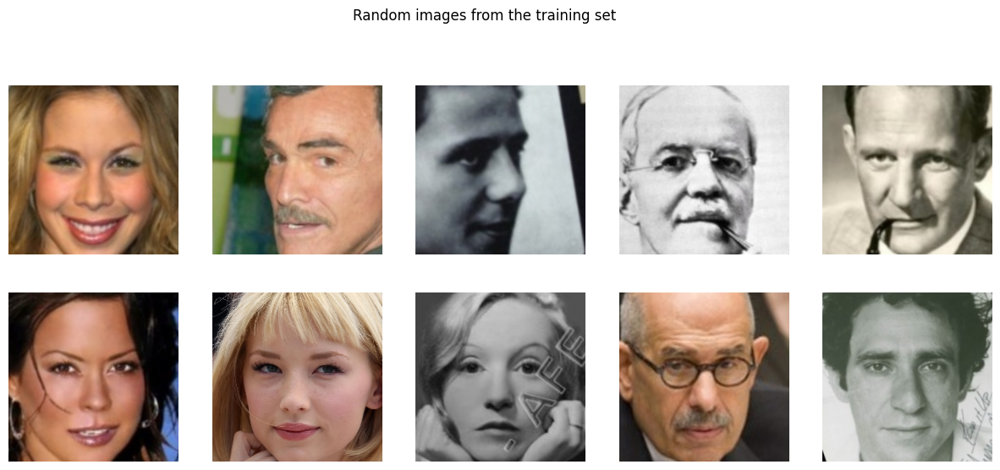

In [ ]:
show_images(df_train.sample(10), image_dir, title='Random images from the training set')

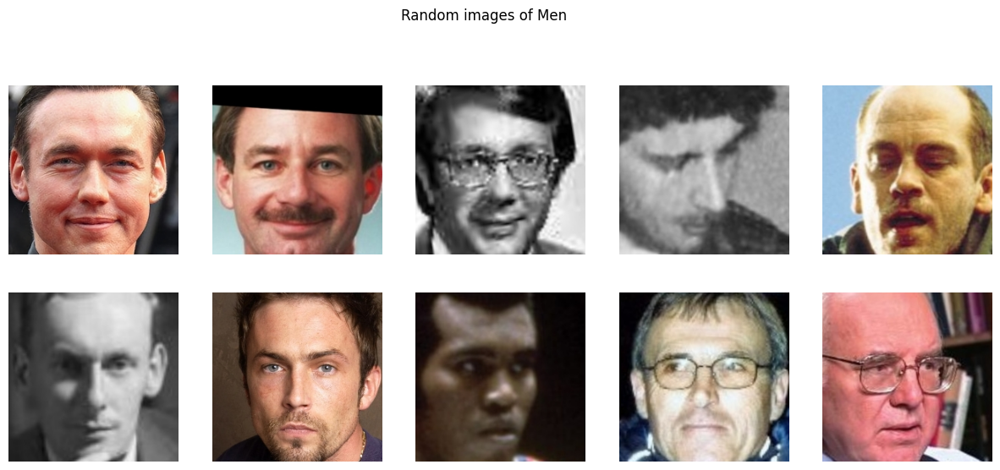

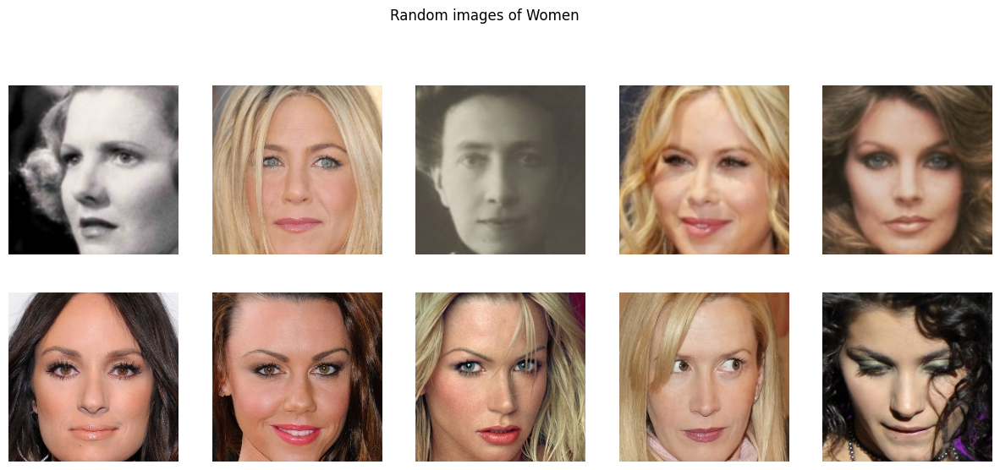

In [ ]:
men = df_train[df_train['gender']>0.5]
women = df_train[df_train['gender']<0.5]

show_images(men.sample(10), image_dir, title='Random images of Men')
show_images(women.sample(10), image_dir, title='Random images of Women')

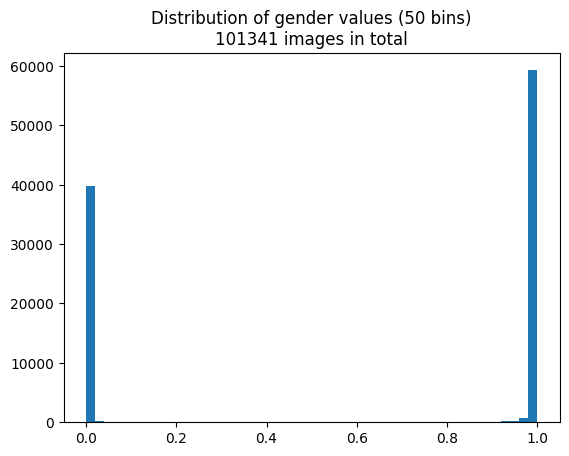

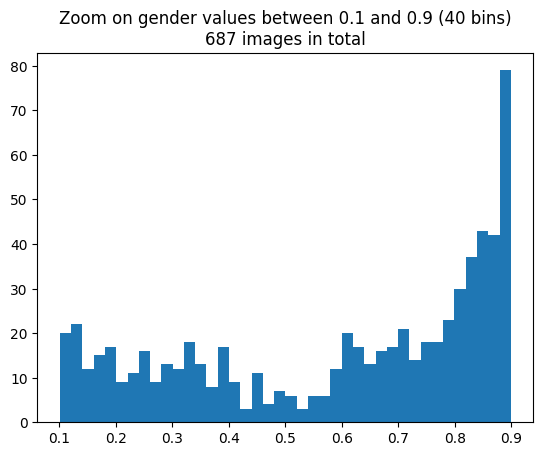

67


In [ ]:
# Plot histogram of Gender with 50 baskets
# 0 = Women and 1 = Men
plt.hist(df_train['gender'], bins=50)
plt.title('Distribution of gender values (50 bins)\n'+str(df_train.shape[0])+' images in total')
plt.show()

# Plot histogram of gender between 0.1 and 0.9 with 40 baskets
gender_mixed = df_train[(df_train['gender'] > 0.1) & (df_train['gender'] < 0.9)]
plt.hist(gender_mixed['gender'], bins=40)
plt.title('Zoom on gender values between 0.1 and 0.9 (40 bins)\n'+str(gender_mixed.shape[0])+' images in total')
plt.show()
df_gender_4_6 = df_train[(df_train['gender'] > 0.4) & (df_train['gender'] < 0.6)]
print(len(df_gender_4_6))

Men


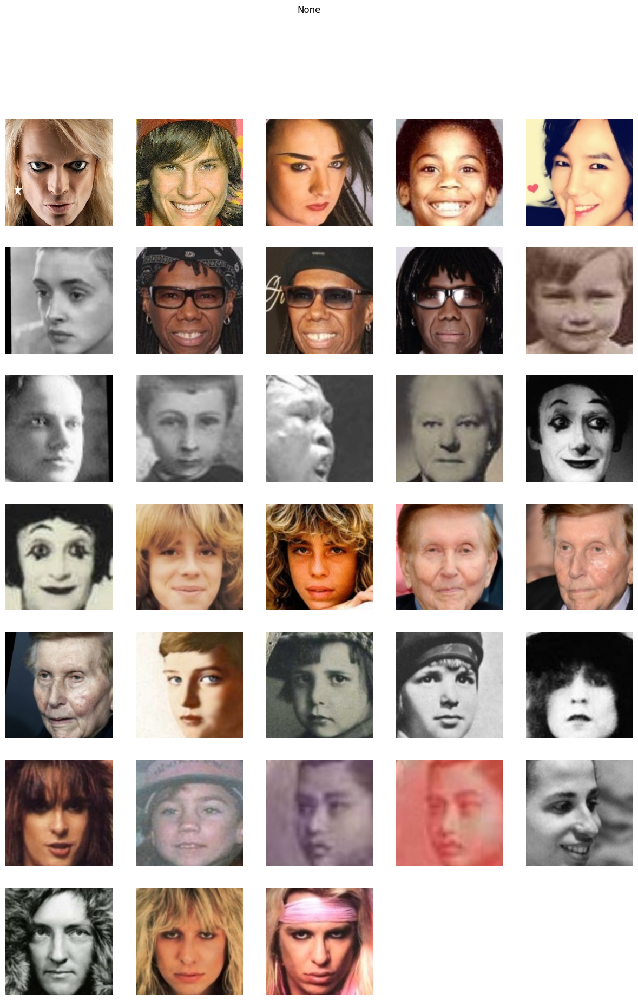

Women


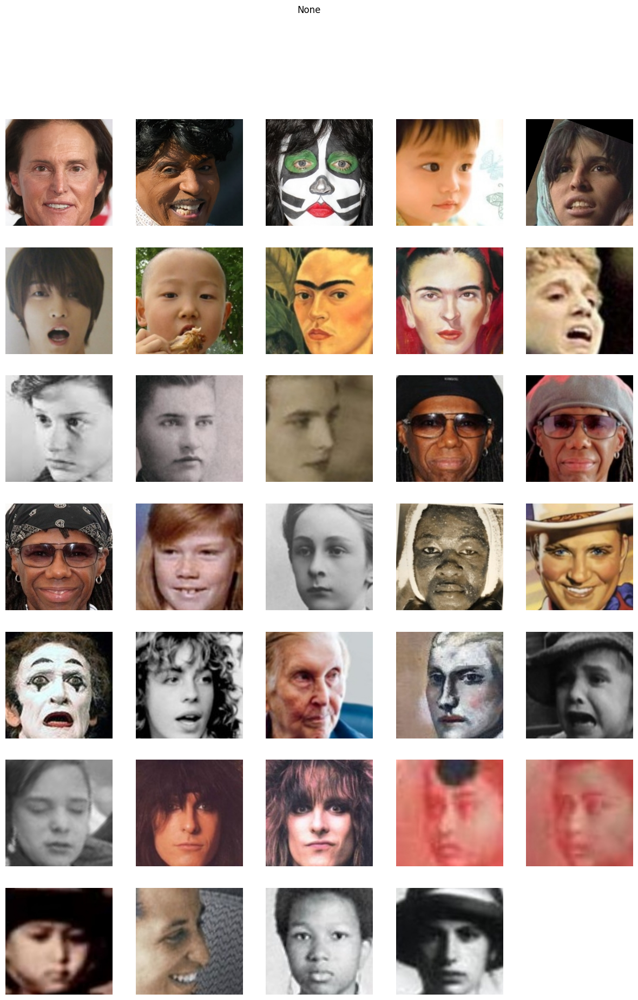

In [ ]:
# show images in df_gender_4_6 (5 on each row)

#show_images(df_gender_4_6, image_dir, n_images=5)
# plot woman gender>0.5
print('Men')
show_images(df_gender_4_6[df_gender_4_6['gender'] > 0.5], image_dir, n_images=5)
print('Women')
show_images(df_gender_4_6[df_gender_4_6['gender'] < 0.5], image_dir, n_images=5)

## 1.1. Face occlusion Distribution analysis

n 101341


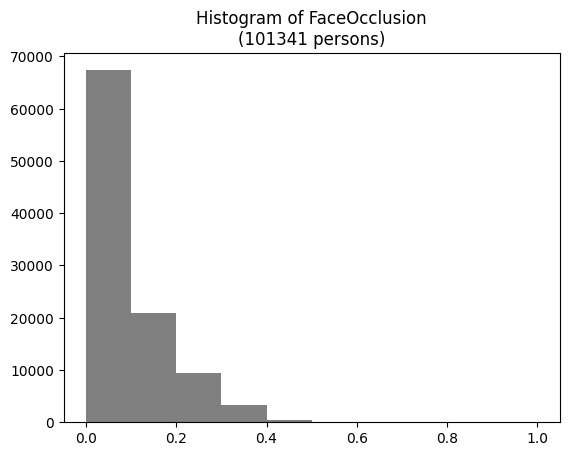

In [ ]:
# Plot histogram of Faceocclusion with 10 baskets
n = df_train.shape[0]
print('n',n)
plt.hist(df_train['FaceOcclusion'], bins=10,color='gray')
plt.title('Histogram of FaceOcclusion\n('+str(n)+' persons)')
plt.show()

Text(0.5, 1.0, 'number of men and women in each bin of 0.01 of FaceOcclusion')

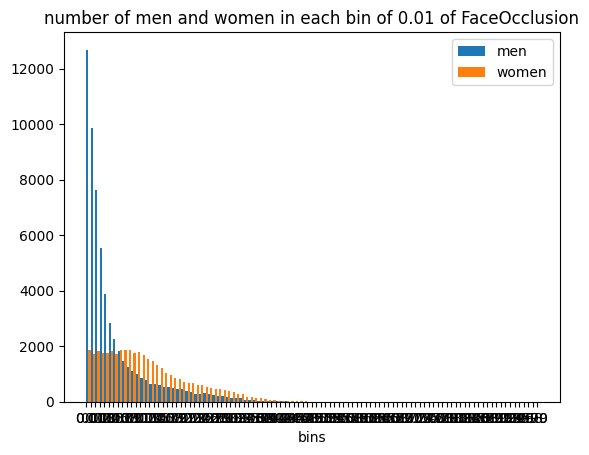

In [ ]:
n_bins = 100

# Extracting histogram values for men
counts_men, bin_edges_men = np.histogram(men['FaceOcclusion'], bins=n_bins)

# Extracting histogram values for women
counts_women, bin_edges_women = np.histogram(women['FaceOcclusion'], bins=n_bins)

plt.bar(np.arange(n_bins)+0.25,counts_men, label = "men",width=0.5)
plt.bar(np.arange(n_bins)+0.75,counts_women, label = "women", width=0.5)
plt.legend()
plt.xlabel('bins')
plt.xticks(np.arange(n_bins+1),np.arange(n_bins+1)/n_bins, )
plt.title('number of men and women in each bin of '+ str(1/n_bins)+' of FaceOcclusion')

# IMAGES BY DESCENDING OCCLUSION

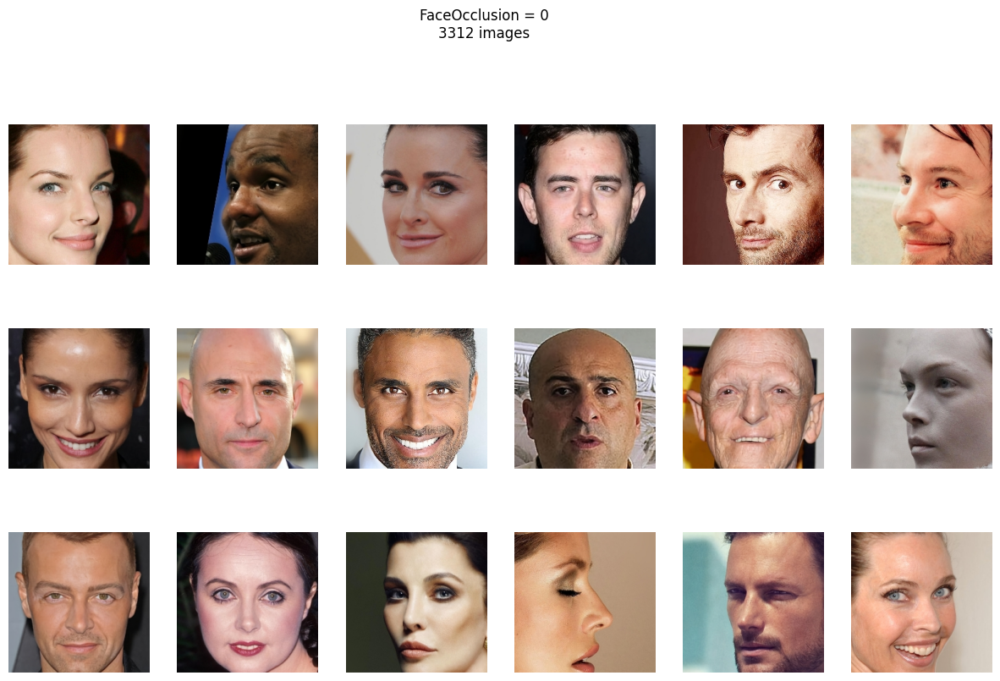

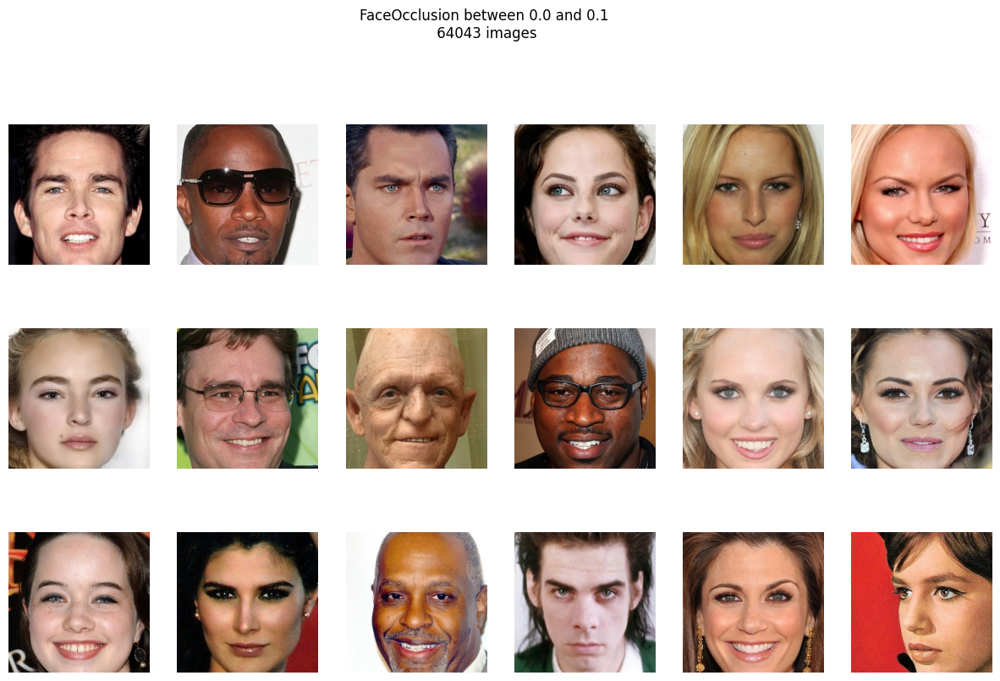

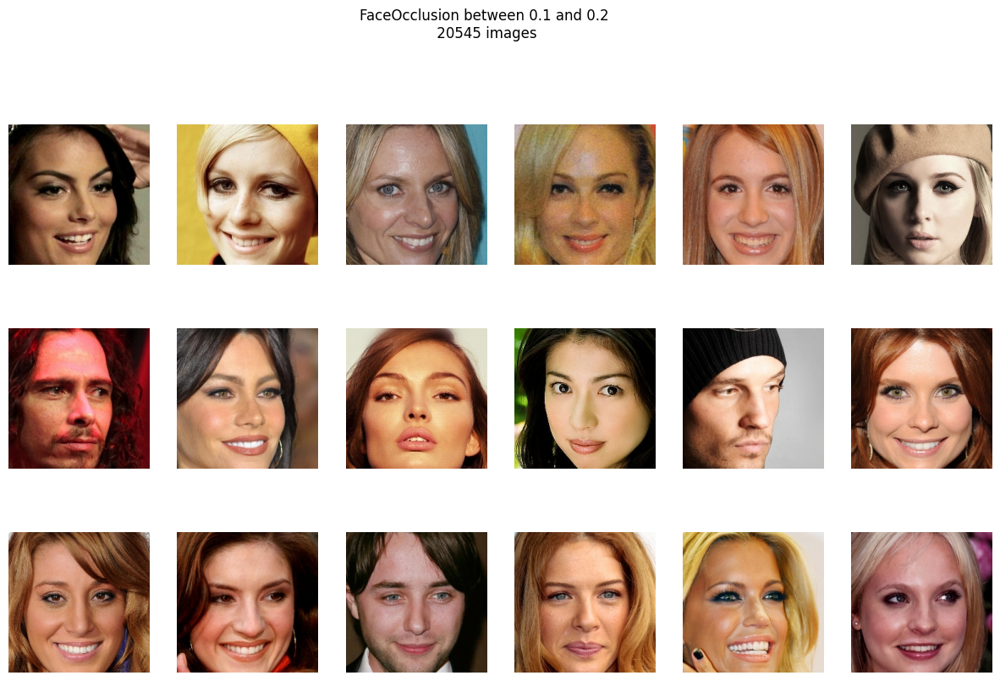

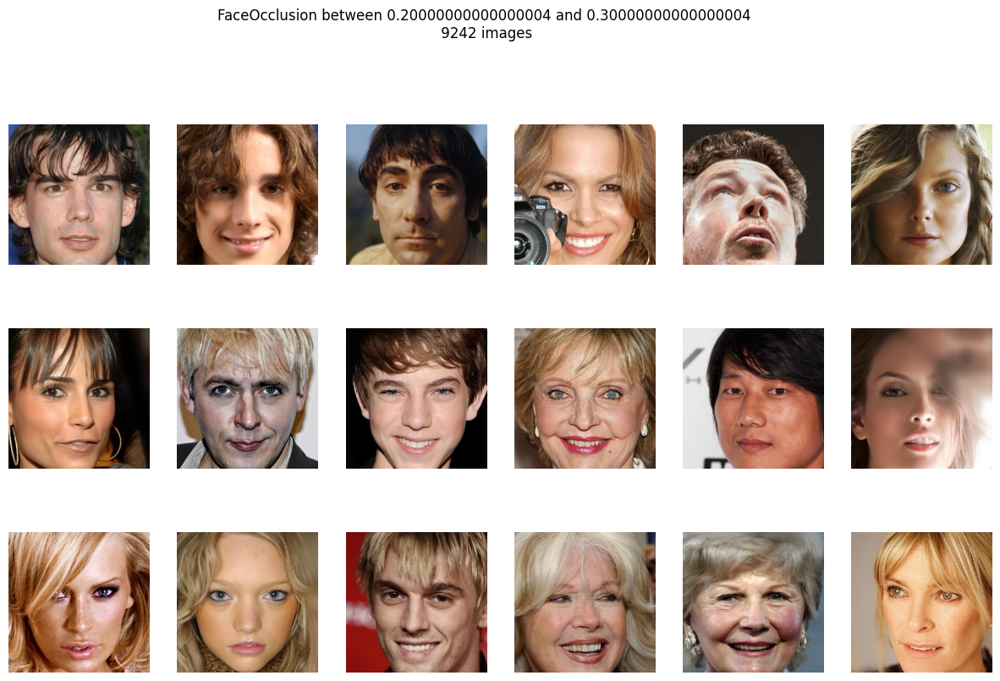

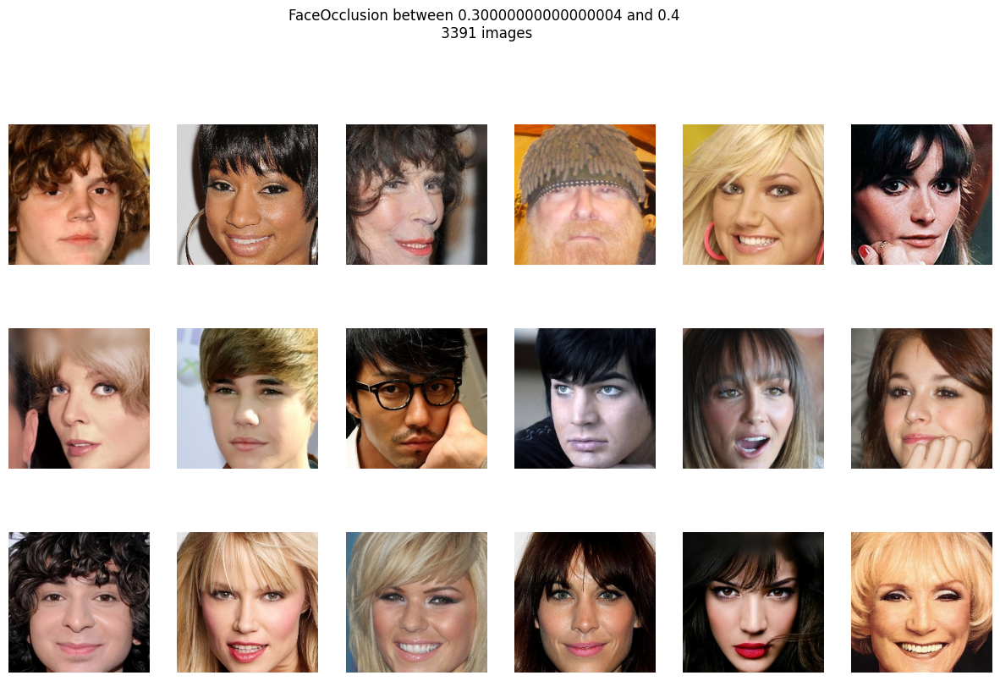

...

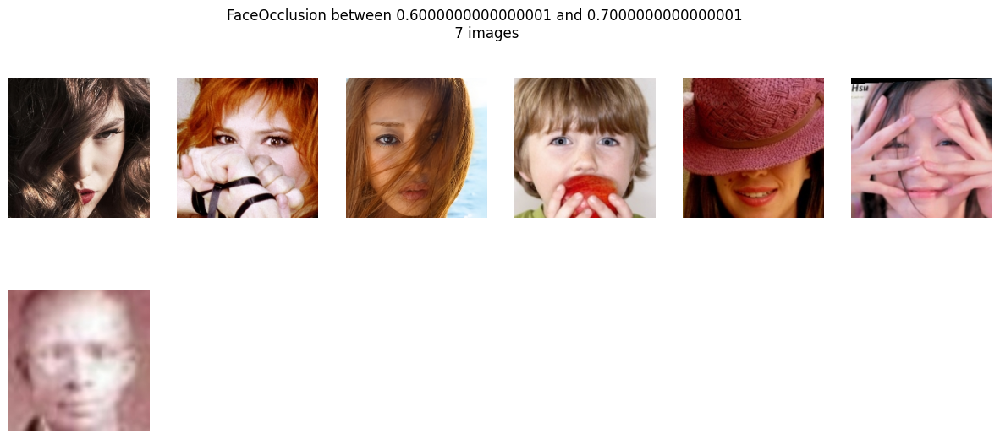

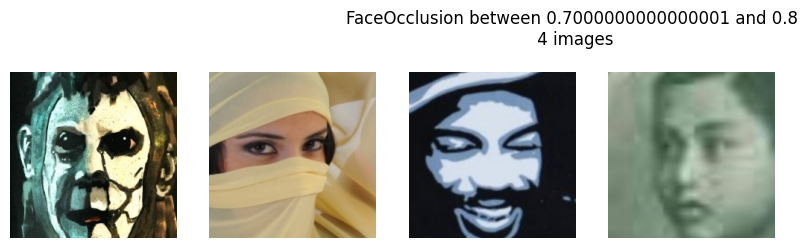

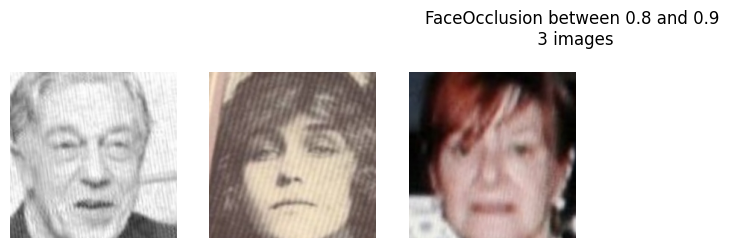

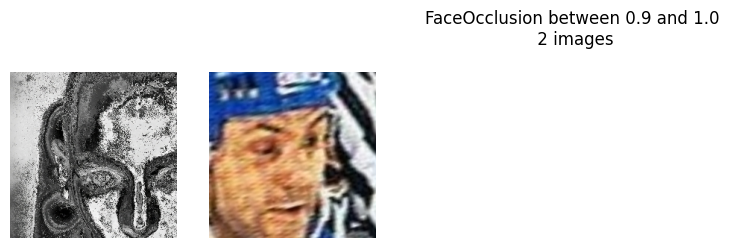

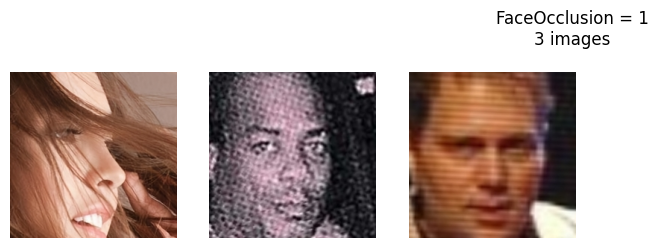

In [ ]:
# show images grouped by occlusion level

bins = np.arange(0.1, 1.1, 0.1)
n_img = 18

# Show images with FaceOcclusion = 0, ]0, 0.1[, ]0.1, 0.2[, ... ]0.9, 1], =1
show_images (df_train[df_train['FaceOcclusion']==0].head(n_img), image_dir, n_images=6, title="FaceOcclusion = 0\n"+str(len(df_train[df_train['FaceOcclusion']==0]))+" images")
for b in bins:
    selection = df_train[(df_train['FaceOcclusion'] > b - 0.1 ) & (df_train['FaceOcclusion'] < b)]
    title_bin = f"FaceOcclusion between {b - 0.1} and {b}\n {len(selection)} images"
    show_images (selection.head(n_img), image_dir, n_images=6, title=title_bin)
show_images (df_train[df_train['FaceOcclusion']==1].head(n_img), image_dir, n_images=6, title="FaceOcclusion = 1\n"+str(len(df_train[df_train['FaceOcclusion']==1]))+" images")

# 1.3 Explore by data set and black and white images

In [ ]:
# Create a column with the database number

df_train['db_number'] = df_train['filename'].apply(lambda x: x[8:9])

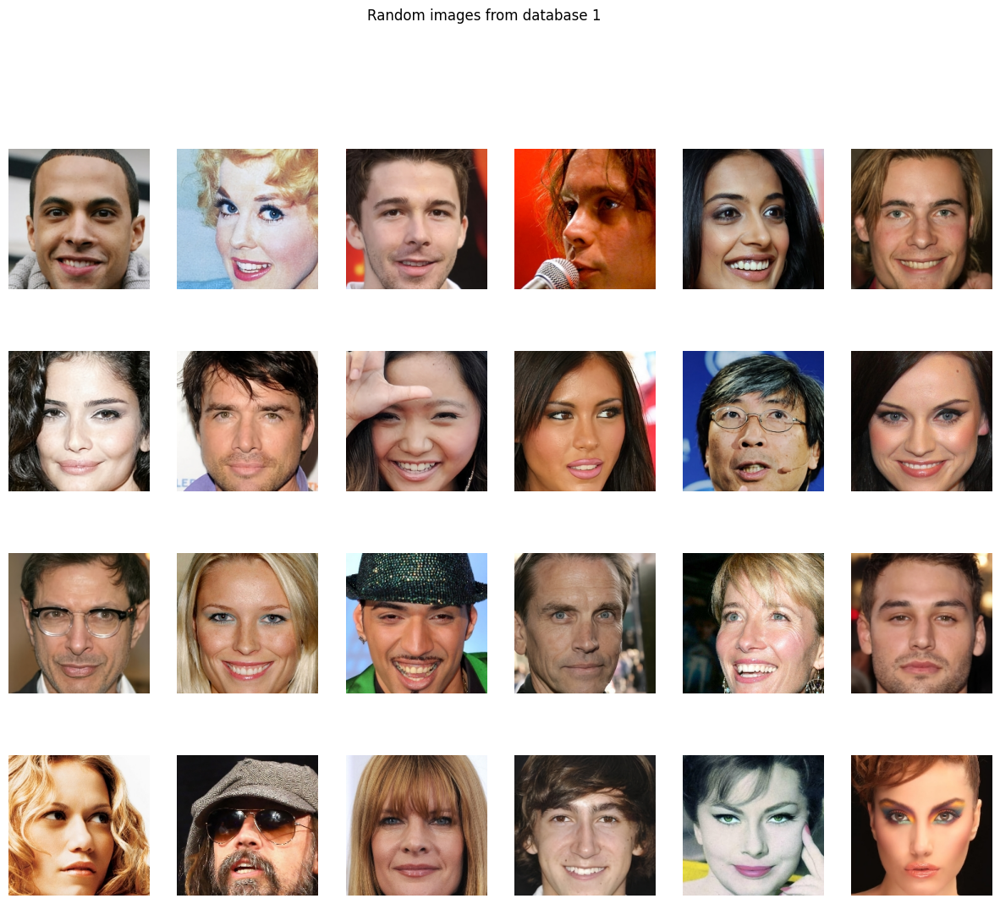

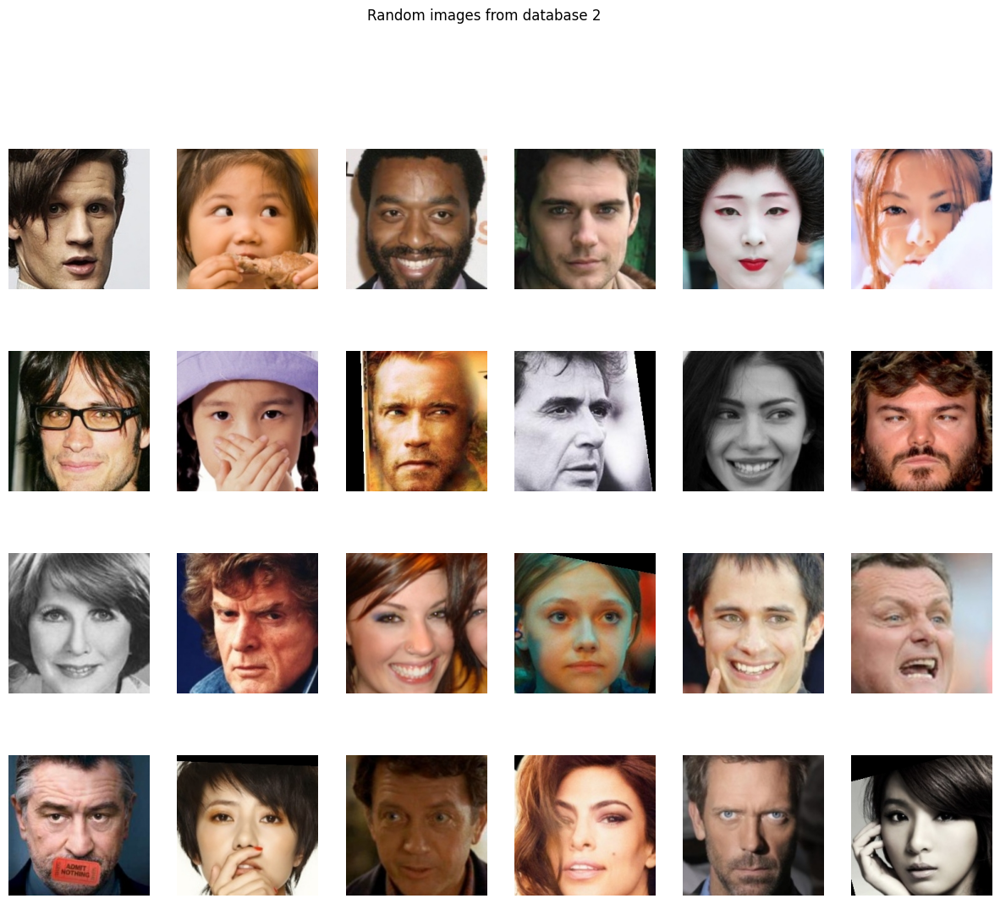

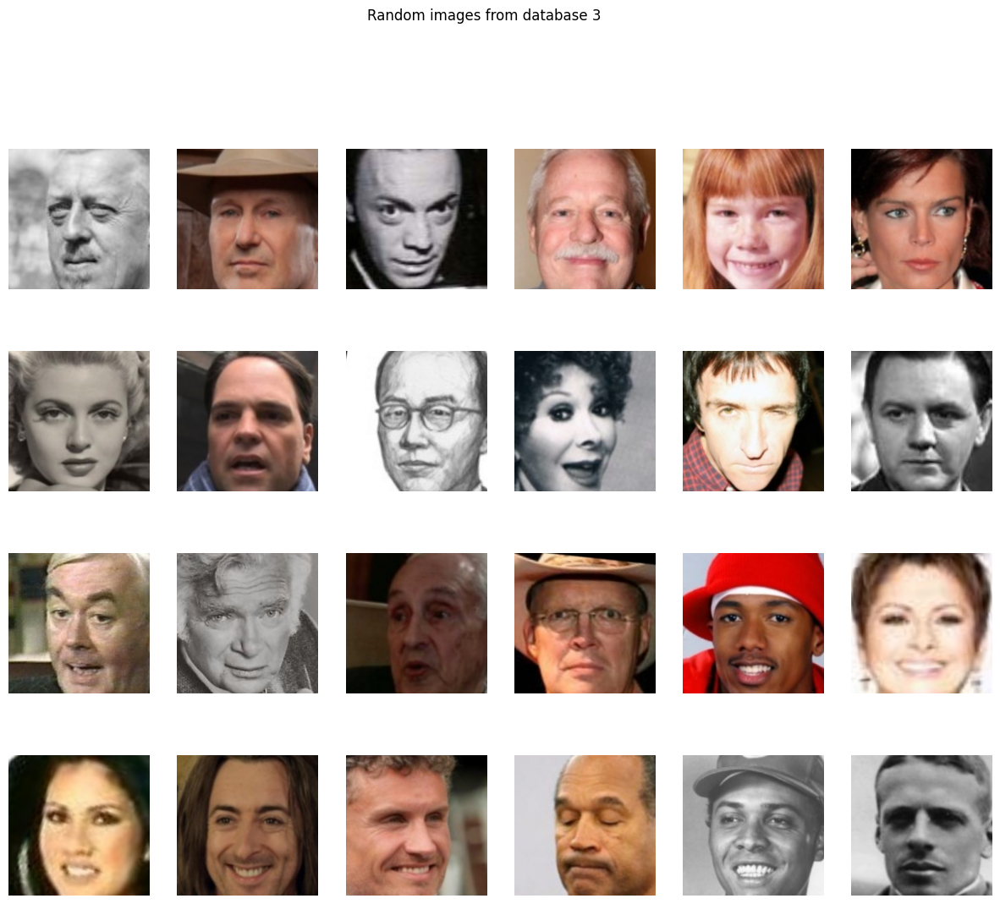

In [ ]:
df_1 = df_train[df_train['filename'].str.contains('database1', na=False)]
df_2 = df_train[df_train['filename'].str.contains('database2', na=False)]
df_3 = df_train[df_train['filename'].str.contains('database3', na=False)]

n_samples = 24
show_images(df_1.sample(n_samples), image_dir, n_images=6 ,title='Random images from database 1')
show_images(df_2.sample(n_samples), image_dir, n_images=6 ,title='Random images from database 2')
show_images(df_3.sample(n_samples), image_dir, n_images=6 ,title='Random images from database 3')

In [ ]:




bw_img = Image.open("Data/crops_100K/database3/database3/m.01b_6y/40-FaceId-0_align.jpg")
print('black and white image:',np.array(bw_img).shape, is_black_and_white(bw_img))

color_img = Image.open("Data/crops_100K/database3/database3/m.01b_6y/33-FaceId-0_align.jpg")
print('color image:',np.array(color_img).shape, is_black_and_white(color_img))

# test the function
plt.subplot(1,2,1)
plt.imshow(bw_img)
plt.title('black and white image')
plt.axis('off')
plt.subplot(1,2,2)
plt.imshow(color_img)
plt.title('color image')
plt.axis('off')
plt.show()

NameError: name 'is_black_and_white' is not defined

In [ ]:
# # Add a column to the dataframe with the information if the image is black and white

# res =[]
# width = []
# height = []
# pixels = []
# channels = []

# for i in range(len(df_train)):
#     if i % 5000 == 0: print(i)

#     # get image information
#     width.append(img.size[0])
#     height.append(img.size[1])
#     pixels.append(img.size[0]*img.size[1])
#     channels.append(len(np.array(img).shape))

#     # check if image is black and white
#     img = Image.open(f"{image_dir}/{df_train.iloc[i]['filename']}")
#     res.append( is_black_and_white(img) )

# for i in range(len(df_train)):
#     if i % 5000 == 0: print(i)
#     img = Image.open(f"{image_dir}/{df_train.iloc[i]['filename']}")
#     res.append( is_black_and_white(img) )

# df_train['black_and_white'] = res
# df_train['image_width'] = width
# df_train['image_height'] = height
# df_train['pixels'] = pixels
# df_train['channels'] = channels

In [ ]:
# Explore other features
# ---------------------- 
# skin color
# age
# glasses
# hair color
# hair length
# facial hair
# head pose
# hat

# SAVE DATAFRAME

In [ ]:
import pickle

In [ ]:
with open('df_train.pkl', 'wb') as f:
    pickle.dump(df_train, f)

In [ ]:
# open the file for reading
with open('df_train.pkl', 'rb') as f:
    df_train = pickle.load(f)